#  A hybrid network and topic analysis of the competence research area in educational contexts

**Details**
* *Author.* Felipe Urrutia Vargas
* *Contributions.* 
    * Methodology
    * Software 
    * Validation 
    * Investigation 
    * Data curation 
    * Visualization 
* *Date.* 16/07/2022
* *Article.* doi/...

**Content**
* [Methodology](#Methodology)
    * []()
* [Direct citation graph analysis](#Direct-citation-graph-analysis)
    * [Load data](#Load-data)
    * [Exploratory data analysis](#Exploratory-data-analysis)
* [Latent semantic analysis (LSA) per cluster](#Latent-semantic-analysis-(LSA)-per-cluster)
    * [Preprocess data](#Preprocess-data)
    * [LSA per cluster](#LSA-per-cluster)
        * [Cluster 1](#Cluster-1)
        * [Cluster 2](#Cluster-2)
        * [Cluster 3](#Cluster-3)

---
# Methodology

<img src="Methodology diagram.png" />

## Data acquisition


### Criterias

<!-- que es un motor de busqueda? -->

Four key phrases were used to perform the query with the SCOPUS search engine. These are (1) "competence-based education", (2) "competence-based training", (3) "competence-based curricul*" and (4) "key competenc*". The results correspond to those papers containing at least one of these phrases in the title, abstract or keywords of the scientific paper. For this type of search, the *TITLE-ABS-KEY* field was used. In effect, the query is performed with the following instance:

$\texttt{TITLE-ABS-KEY ( ( "competence-based education" OR "competence-based training" OR "competence-based curricul*" OR "key competenc*" ) )}$

The retrieved documents go through three types of filters: (1) Document type, (2) Sub-area and (3) Language. In our search, for (1) two possible document types were chosen: articles (ar) or reviews (re). While for (2) and (3), only documents in the sub-area of Social science (SOCI) and English, resp. These filters are added to the above query with the following instance:

* $\texttt{LIMIT-TO ( DOCTYPE , "ar" ) OR LIMIT-TO ( DOCTYPE , "re" )}$

* $\texttt{LIMIT-TO ( SUBAREA , "SOCI" )}$

* $\texttt{LIMIT-TO ( LANGUAGE , "English" )}$

### Datos recuperados

* Title of the document
* Abstract
* Author keywords
* Year of publication
* Authors
* Source of publication

## Direct citation network analysis

To take advantage of the structure from citations between documents, a graph will be created where the nodes are documents and the edges indicate whether one of the connected documents is cited by the other. This type of graph with scientific papers is called a direct citation network [citation](https://journals.sagepub.com/doi/10.1177/0165551520962775).

<!-- que es un grafo? -->

### VOSviewer, mapping and clustering

In order to visualize and group the documents of the direct citation network, the VOSviewer tool is used. This software automatically builds the network of interest and unifies two important applications for network analysis [citation](https://doi.org/10.1016/j.joi.2010.07.002). The first one is the projection of the network in two dimensions, called mapping. While the other is a document grouping by similarity with clustering, a non-supervised learning technique to find groups in the data.

According to [citation](https://doi.org/10.1016/j.joi.2010.07.002), given a graph (network) of $n$ nodes (documents) we define $c_{ij}$ as the variable that indicates with a $1$ if document $i$ is connected to document $j$ in the direct citation network, and with a $0$ otherwise. The matrix with the coefficients $c_{ij}$, is called the adjacency matrix of the network. To find a mapping, or clustering $(x_1,..., x_n)$ of the nodes (documents) of the network, it is sufficient to minimize the following function:

$$V(x_1, ..., x_n) = \sum_{i<j} s_{ij}d_{ij}^2 - \sum_{i<j} d_{ij}$$

where $s_{ij}$ is the strength between node $i$ and node $j$ (e.g. $s_{ij} = c_{ij}$). While $d_{ij}$ denotes the distance between node $i$ and node $j$, and its form depends on whether one wishes to map or cluster. In the first case, the distance is given by the Euclidean norm, i.e. $d_{ij} = || x_i - x_j ||_2$. In the second case, the distance is a weighted indicator that is worth $0$ if the cluster of document $i$ is the same as that of document $j$ (i.e., $x_i = x_j$), and with a $\gamma^{-1}$ otherwise. The positive constant $\gamma$ is usually called resolution and allows the number of clusters to modulate positively with the magnitude of its value.

VOSviewer will be used on two applications on the direct citation network. The first time is to find the largest connected component in the direct citation network, or subgraph with the largest number of nodes, by means of clustering without edge weighting (no normalization). This means that the strength between nodes corresponds to the values of the adjacency matrix of the network used, i.e. $s_{ij} = c_{ij}$. The second time is to analyze the largest connected component and cluster its documents into well-defined groups, for further topical analysis. This time, for clustering the edges are normalized with the association strenght technique [citation](https://doi.org/10.1002/asi.21075), allowing more cited documents to attract more those documents that cite them as opposed to those that do not. For this the strength between nodes is given by $s_{ij} = \frac{2 M c_{ij}}{c_i c_j},$ where $M = \frac{1}{2} \sum_{k} c_k$ with $c_i = \sum_{i\neq k} c_{ik}$.

To obtain our results with the VOSviewer tool, we used version 1.6.18 of the tool from the website https://www.vosviewer.com/ (authors accessed on 2022, July).

## Topic analysis with LSA

<!-- que es un topico? -->

### Processing a document

<img src="lsa_processing.png" />

Each document has a description based on attributes, such as its title, abstract, keywords, authors, year of publication, among others. For the extraction of topics in a collection of documents (corpus) with the LSA technique, we will assume that each document is a single large text. This time, the attributes that make up a document will only be those that possess potential key terms of interest, such as title, abstract and keywords [citation](https://doi.org/10.1016/j.chb.2019.106177). In effect, a document $\texttt{doc}$ is the concatenation between its title, abstract and keywords, i.e. $\texttt{doc} = \texttt{title} + \texttt{abstract} + \texttt{keywords}$.

Preprocessing is an important part of any text mining algorithm [citation](https://doi.org/10.3390/ijgi6070195). Removing and simplifying parts of the text allows to speed up and improve the results in this type of algorithms [citation](https://doi.org/10.1109/ICAIET.2014.21). The following filters are applied on each document (doc):

* *Replace some keyphrases.* Some phrases may be decoupled after applying other filters (e.g. removal of punctuation symbols). Therefore, some keyphrases are replaced and simplified by a single text unit, e.g. "m-learning" is replaced by "mlearning".

* *Remove punctation symbols.* For the extraction of important terms by topic we will only focus on those text units that are words. Therefore, special characters such as punctuation symbols are removed from the text. Some of these units are e.g. :, ., -.

* *Remove stop-words.* There are words that stand out for their abundance in any given corpus, called stop-words. This type of words are usually irrelevant due to their high frequency in all the documents of the corpus. For this reason, words such as e.g. a, for, to, what, in, and, the, are eliminated from all corpus documents.

* *Uncased tokens.* Transforming words in a text to lowercase can make two words written differently the same. An example of this is the key phrase "Key Competencies" which is different from "key competencies", but under the transformation they remain the same. This simple modification allows to leave equivalent both ways of mentioning the same thing.

* *Lemmatize tokens.* Another way to transform the words of a text is to reduce the variations of a word with only one common word, e.g. replace "competencies" by "competency". This technique is called Lemmatization, and allows to significantly reduce the vocabulary without losing interpretability of what is obtained. Methods such as Stemming, allow to reduce these and other variations of a word with only one root unit (e.g. transform "competency" by "compet"). However, such aggressive methods on words can negatively affect the understanding and interpretability of topical term analysis [citation](https://doi.org/10.1177/0165551520962775).

* *Remove specific words.* Particular words that appear frequently in the documents are eliminated to avoid impairing the topical analysis [citation](https://doi.org/10.1016/j.autcon.2015.07.012), e.g. "sustainability".

* *Expand some abbreviations.*  Some text units such as abbreviations combine several words in only a few characters, e.g. "cbe" for "competence base education". The information stored by abbreviations can be lost during the retrieval of latent topics in a corpus, so such units must be expanded into their corresponding words. Expanding abbreviations is a current problem in NLP, since abbreviations are ambiguous and can have more than one valid expansion [citation](https://doi.org/10.1007/978-981-13-1921-1_12). Therefore, each abbreviation belonging to the corpus is replaced manually and in a supervized way [citation](https://doi.org/10.1016/j.chb.2019.106177). 

After the preprocessing of a document, each text is decomposed into minimal units (n-grams) that will form the document-term matrix. This stage consists of segmenting the text into smaller units, e.g. words. In our case we will use uni-grams (or 1-grams), e.g. "key competence education" is segmented by ["key", "competence", "education"]. Although the use of these units allows us to obtain reasonable results [citation](https://doi.org/10.1109/RCIS.2015.7128906), we will also consider bi-grams (or 2-grams), units that allow us to obtain more meaningful terms than uni-grams [citation](http://dx.doi.org/10.1109%2FICDM.2007.86). For example, the sentence in the previous example is segmented by ["key competence", "competence education"]. We discard the use of n-grams with n greater than 2, as this may worsen the performance of topical semantic analysis, because the vocabulary grows considerably and the frequency of long units declines radically [citation](https://doi.org/10.1109/RCIS.2015.7128906), [citation](https://www.semanticscholar.org/paper/A-Study-Using-%24n%24-gram-Features-for-Text-F%C3%BCrnkranz/3a4f7eca26ee30aeb798a0eef2c08dd7a1cbad01). Henceforth, the uni- and bi-grams of a document will be referred to as document terms.

The preprocessing and tokenization of the text is performed with the help of the Spacy library, widely known and used in text processing for NLP problems [citation](https://books.google.cl/books?id=lVv6DwAAQBAJ). It can be found at https://spacy.io/ (authors accessed 2022, July).

### Term Frecuency-Inverse Document Frecuency (TF-IDF)

For topical analysis, the corpus will be simplified by a document-terms matrix. In this matrix, each column represents a document and each row is associated with a term (uni- and bi-gram). The matrix coefficient at position $(i, j)$ corresponds to the number of times that term $i$ occurs in document $j$, denoted by $\text{tf}_{ij}$. The representation of a document from word frequency in a sparse per-term vector is called bag-of-words (bow). In contrast to the frequency of a term in a single document, the frequency of occurrence of terms in all documents of the corpus is important for finding topics. Terms that always occur throughout the corpus should be of less importance than terms that occur in only a few documents, since a topic is characterized by terms of the latter type. To compensate for this, the document-term matrix is updated with coefficients that consider this importance but without forgetting the $\text{tf}_{ij}$. Such a matrix is called term frequency - inverse document frequency, or tf-idf for short. Unlike the bow representation matrix, the $\text{tf}_{ij}$ value is weighted by the logarithm of the inverse of the probability of finding the term $i$ in any document in the corpus. In effect, the matrix tf-idf is given by:
$$
A^{\text{tf-idf}}_{ij} = \text{tf}_{ij} \cdot \log \left(\frac{n}{\text{df}_{i}}\right)
$$
where $\text{df}_i$ is the number of documents in the corpus in which the term $i$ occurs and $n$ is the size of the corpus.

To efficiently construct the tf-idf matrix from our corpus of interest, we use the open source python library called Gensim.  This library is available at https://radimrehurek.com/gensim/ (authors accessed in July, 2022). To compute the tf-idf matrix we use the $\texttt{tfidfmodel}$ class of the $\texttt{models}$ module (to use $\texttt{tfidf}$, go to https://radimrehurek.com/gensim/models/tfidfmodel.html).

### Singular Value Decomposition (SVD)

<img src="SVD.png" />
* In our case, $M$ is the matrix $A^\text{tf-idf}$.

For an $M$ matrix of dimension $m \times n$, its singular value decomposition (svd) is a factorization of the form $U \Sigma V^T$, where $\Sigma$ is a matrix of $r \times r$, $U$ of $m \times r$ and $V$ of $n \times r$, with $r$ the rank of the $M$ matrix. In its compact version, $\Sigma$ is a diagonal matrix with the roots of the eigenvalues of $M$ ordered from largest to smallest, $U$ a matrix with the eigenvectors of $MM^T$ and $V$ with those of $M^TM$, in the same order as the assignment of the coefficients of $\Sigma$. 

In our case, $M$ will be the tf-idf matrix associated with the corpus of interest, denoted by $A^\text{tf-idf}$. The $\Sigma$ matrix is called Topic strenght, while the $U$ and $V$ matrices are called Term-topic and Document-topic, resp. As the name of the matrices indicates, $\Sigma$ stores the strengths of each topic from the strongest to the weakest. The $U$ and $V$ matrices, on the other hand, store the projections of each term and document, resp., on the $r$ topics (in the same order). 

Now, since there should be no repeated documents and the number of terms is considerably larger than the number of documents ($n>>m$), then $r$ is usually equal to $n$. That is, as many topics as documents. This is a problem, since for a topical analysis one wishes to find non-trivial groups of documents (singletons). To solve this, one chooses as topics those first $k$ singular values with the largest contributions in the $\Sigma$ matrix. As the values of its diagonal are ordered in descending order, then it suffices to truncate the matrix up to the first $k$ rows and $k$ columns, a new matrix denoted by $\Sigma|_k$. This procedure is analogous for truncating the $U$ and $V$ matrices, now denoted by $U|_k$ and $V|_k$. Note that $U|_k \Sigma|_k V|_k$ is an approximation of $A^\text{tf-idf}$, where $k=r$ completely recovers the original matrix.

To efficiently compute the singular value decomposition (SVD) of the tf-idf matrix, we use the open source Python library called Gensim.  To compute SVD, we use the $\texttt{lsimodel}$ class of the $\texttt{models}$ module (to use $\texttt{lsimodel}$, go to https://radimrehurek.com/gensim/models/lsimodel.html).

### Selecting sufficient number of topics

Choosing the optimal number of topics with the LSA technique is still an ongoing problem [citation](https://garuda.kemdikbud.go.id/documents/detail/1669053). Some use heuristics [citation](https://doi.org/10.2307/25148852), [citation](https://doi.org/10.1016/j.autcon.2015.07.012), while others use techniques similar to those used to find the optimal number of clusters for clustering algorithms [citation](https://doi.org/10.1111/deci.12095). In our case, we will use the option proposed by clustering techniques but for the case of LSA, called Elbow of eigenvalues [citation](https://doi.org/10.1111/deci.12095). 

This method consists of plotting the eigenvalues of $M$ as a function of their relative size in a descending order, i.e. first the largest eigenvalue, then the second largest, and so on until the smallest one is reached. Subsequently, identify the instant when the values (1) stop decreasing rapidly and (2) start decreasing slowly, a place called the elbow of the graph. This instant indicates the smallest number of topics such that the contribution of adding another topic is marginal with respect to the contribution of the last selected topic [citation](https://doi.org/10.1016/j.csda.2005.09.010). 

To compute the eigenvalues, we use the open source Python for mathematics, science, and engineering library called SciPy. To find the $k$ eigenvalues of the tf-idf matrix, we use the $\texttt{eigs}$ function of the $\texttt{sparse.linalg}$ module (to use $\texttt{eigs}$, go to https://docs.scipy.org/doc/scipy/reference/generated/scipy.sparse.linalg.eigs.html).

###  Selecting fences per topics

After choosing an appropriate number of $k$-topics, we are left with the truncated versions of the $U$ term-topic and $V$ document-topic matrices. Thus, for a topic $t$ of the selected $k$, the $t-$th column of $U$ stores the contribution of each term to that topic. That is, for a term $i$, the absolute value of $U_{it}$ corresponds to the proximity of term $i$ to topic $t$ [citation](https://doi.org/10.3390/ijgi6070195). Since the columns of $U$ are usually non-constant, it is natural to think that there are terms with greater proximity than others. Terms with greater proximity are better able to represent the topical than those with less proximity. 

To interpret the selected topics, it is required to determine whether or not a term belongs to a topic. For this, we will use minimum proximity cutoffs that will depend on $U$ and the topic of interest. This criterion, consists in that for a topic $t$ with cutoff $\phi_t$, the term $i$ will belong to the topic if and only if its proximity to the topic $t$ is greater than the minimum cutoff, that is, $|U_{ti}| \geq \phi_t$. The minimum cutoff $\phi_t$ is calculated as the mean plus one standard deviation of the distribution of the absolute values of the $t-$th column of $U$ [citation](https://doi.org/10.1016/j.chb.2019.106177). According to this criterion we denote by $T_t$ the set of terms of the $t$-topic.

Analogously, we can determine the set of documents of a topic. This time we will use the document-term matrix with tf-idf and the terms $T_t$ for each topic $t$. For this, the proximity of a document to a topic $t$ is the normalization of the sum of the tf-idf weights of the document terms that are in $T_t$ multiplied by the proximity of each term to the topic $t$. In effect, if we consider $\bar{U}_{it}$ equal to $|U_{it}|$ if the term $i$ is in the topic $t$ and zero otherwise, then the unnormalized version of the proximities of each document is $W = (A^\text{tf-idf})^T\bar{U}$. We denote by $\bar{W}$ the normalized version of $W$, defined as a row-weighted $W$ version such that each row of $W$ adds up to $1$.  Thus, document $j$ will belong to the topical if and only if $\bar{W}_{jt}$ is greater than the minimum cutoff $\theta_t$. Where the minimum cutoff $\theta_t$ is calculated as the mean plus one standard deviation of the distribution of the values in the $t-$th column of $\bar{W}$ [citation](https://doi.org/10.1016/j.chb.2019.106177). We denote by $D_t$ the set of documents of the $t$-topic.

### Topic Labeling

<!-- nombrar los topicos a partir de una interpretación de los conjuntos de palabras -->

---
# Direct citation graph analysis

https://app.vosviewer.com/?json=https://drive.google.com/uc?id=1zvpZVz6r3-kkoSw8BUzPg8aOfU0Iasz4

## Load data

### Load libraries

In [1]:
from util import *

C:\Users\felip\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\felip\anaconda3\lib\site-packages\numpy\.libs\libopenblas.EL2C6PLE4ZYW3ECEVIV3OXXGRN2NRFM2.gfortran-win_amd64.dll
C:\Users\felip\anaconda3\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"
C:\Users\felip\anaconda3\lib\site-packages\spacy\util.py:865: UserWarning: [W095] Model 'en_core_web_sm' (3.3.0) was trained with spaCy v3.3 and may not be 100% compatible with the current version (3.4.1). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)


In [2]:
pd.set_option('display.max_colwidth', -1)

C:\Users\felip\AppData\Local\Temp/ipykernel_5592/3652881321.py:1: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


### Load scopus data

In [3]:
df_scopus = read_bibliography(
    file_path="scopus_21_07.csv"
)

In [4]:
df_scopus.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 935 entries, 0 to 934
Data columns (total 55 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   id                             935 non-null    int64  
 1   Authors                        935 non-null    object 
 2   Author(s) ID                   934 non-null    object 
 3   Title                          935 non-null    object 
 4   Year                           935 non-null    int64  
 5   Source title                   935 non-null    object 
 6   Volume                         900 non-null    object 
 7   Issue                          823 non-null    object 
 8   Art. No.                       149 non-null    object 
 9   Page start                     781 non-null    object 
 10  Page end                       781 non-null    object 
 11  Page count                     1 non-null      float64
 12  Cited by                       744 non-null    flo

In [5]:
from matplotlib import pyplot as plt
from matplotlib import rc
import seaborn as sns

plt.style.use(["fast", "classic", "bmh", 'seaborn', "seaborn-dark"][0])
plt.rc('axes', titlesize=14)
plt.rc('legend', fontsize=14)
plt.rc('xtick', labelsize=12)
plt.rc('ytick', labelsize=12)
plt.rcParams.update({'font.size': 16})
plt.rcParams['axes.titlesize'] = 16
plt.rcParams["figure.figsize"] = (10, 6)
plt.rcParams.update({'lines.markeredgewidth': 1})
plt.rcParams.update({'errorbar.capsize': 2})

In [6]:
# o = sub_df.reset_index()
# r = o[o["Year"] >= 2019]["id"].sum()
# r, 100*r/o.sum()

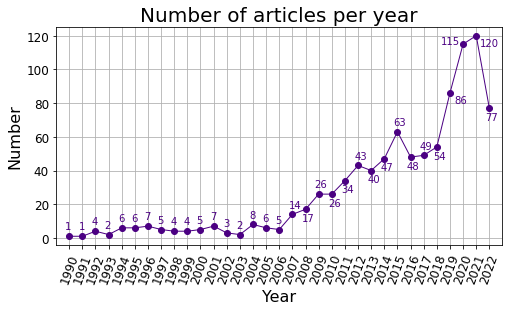

In [77]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4))

sub_df = df_scopus.groupby("Year").count()["id"]
c = "indigo"

ax.plot([str(x) for x in sub_df.index], sub_df, color=c, marker='.', linestyle='-', linewidth=1, markersize=12)

ax.tick_params(axis='x', rotation=70)
ax.set_xlabel("Year")
ax.set_ylabel("Number")
ax.set_title("Number of articles per year", size=20);

ax.set_ylim(bottom=sub_df.min()-5, top=sub_df.max()+5);
ax.set_xlim(left=-1, right=33);


for x, y in enumerate(sub_df):
    if x not in [18, 20, 21, 23, 24, 26, 28, 29, 30, 31, 32]:
        plt.text(x = x-0.3,
        y = y+4,
        s = "{:.0f}".format(y),
        size=10,
        color = c)
    elif x not in [29, 30, 31]:
        plt.text(x = x-0.3,
        y = y-7,
        s = "{:.0f}".format(y),
        size=10,
        color = c)
    elif x not in [30]:
        plt.text(x = x+0.3,
        y = y-6,
        s = "{:.0f}".format(y),
        size=10,
        color = c)
    else:
        plt.text(x = x-1.7,
        y = y,
        s = "{:.0f}".format(y),
        size=10,
        color = c)
ax.grid(True);
plt.savefig("Fig4.pdf", 
               bbox_inches='tight', 
               transparent=True,
               pad_inches=0)

In [8]:
rename = {"Transilvanian Association for the Literarure and Culture of Romanian People (ASTRA)": "ASTRA"}
sub_df;

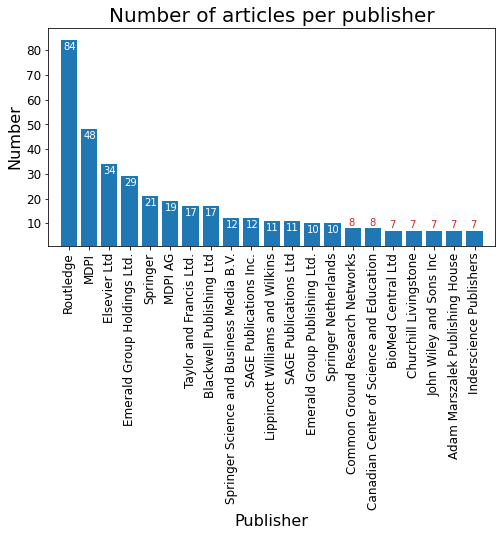

In [9]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
sub_df = df_scopus.groupby("Publisher")["id"].count().sort_values(ascending=False)
top = 30-4-5
names = sub_df.iloc[:top].index
names = [x if x not in rename else rename[x] for x in names]
ax.bar(names, sub_df.iloc[:top]);

ax.tick_params(axis='x', rotation=90)

ax.set_xlabel("Publisher")
ax.set_ylabel("Number")
ax.set_title("Number of articles per publisher", size=20);

ax.set_ylim(bottom=sub_df.min(), top=sub_df.max()+5);
ax.set_xlim(left=-1, right=top);
c = "white"
for x, y in enumerate(sub_df.iloc[:top]):
    if x < 14:
        plt.text(x = x-0.28,
        y = y-4,
        s = "{:.0f}".format(y),
        size=10,
        color = c)
    else:
        plt.text(x = x-0.2,
        y = y+1,
        s = "{:.0f}".format(y),
        size=10,
        color = "tab:red")

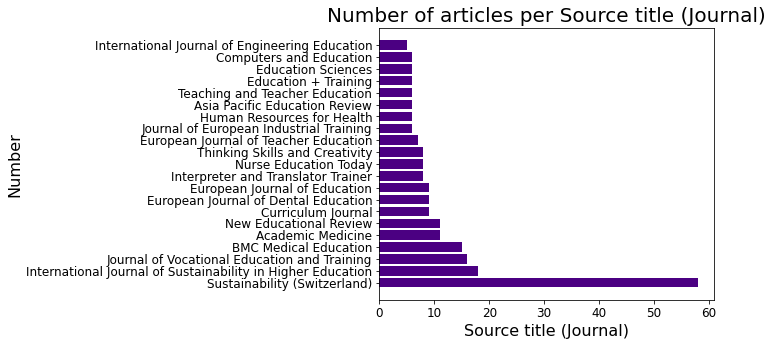

In [78]:
fig, ax = plt.subplots(1, 1, figsize=(6, 5))
sub_df = df_scopus.groupby("Source title")["id"].count().sort_values(ascending=False)
top = 30-4-5
names = sub_df.iloc[:top].index
names = [x if x not in rename else rename[x] for x in names]
ax.barh(names, sub_df.iloc[:top], color="indigo");

ax.tick_params(axis='x', rotation=0)

ax.set_xlabel("Source title (Journal)")
ax.set_ylabel("Number")
ax.set_title("Number of articles per Source title (Journal)", size=20);

# ax.set_ylim(bottom=sub_df.min(), top=sub_df.max()+5);
# ax.set_xlim(left=-1, right=top);
c = "white"
for x, y in enumerate(sub_df.iloc[:top]):
    pass
#     if x < 14-8:
#         plt.text(x = x-0.28,
#         y = y-3,
#         s = "{:.0f}".format(y),
#         size=10,
#         color = c)
#     else:
#         plt.text(x = x-0.2,
#         y = y+1,
#         s = "{:.0f}".format(y),
#         size=10,
#         color = "indigo")
plt.savefig("Fig5.pdf", 
               bbox_inches='tight', 
               transparent=True,
               pad_inches=0)

In [11]:
df_scopus.groupby("Source title")["id"].count().sort_values(ascending=False)

Source title
Sustainability (Switzerland)                                   58
International Journal of Sustainability in Higher Education    18
Journal of Vocational Education and Training                   16
BMC Medical Education                                          15
Academic Medicine                                              11
                                                               ..
International Electronic Journal of Elementary Education       1 
International Education Journal                                1 
Interactive Learning Environments                              1 
Intelligent Systems Reference Library                          1 
International Journal of Sustainable Manufacturing             1 
Name: id, Length: 479, dtype: int64

In [12]:
np.log(2)

0.6931471805599453

In [13]:
# ax = df_scopus["Cited by"].fillna(0).apply(lambda x: np.log(x) if x>0 else -1.5).hist(bins=[-1.75,-0.75, -0.5, 0.5, 1, 2, 3, 4, 5, 6, 7])
count, division = pd.np.histogram(df_scopus["Cited by"].fillna(0).apply(lambda x: np.log(x) if x>0 else -1.5), bins=[-1.75,-0.75, -0.5, 0.5, 1, 2, 3, 4, 5, 6, 7])
# plt.scale("log")

C:\Users\felip\AppData\Local\Temp/ipykernel_5592/1776497180.py:2: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  count, division = pd.np.histogram(df_scopus["Cited by"].fillna(0).apply(lambda x: np.log(x) if x>0 else -1.5), bins=[-1.75,-0.75, -0.5, 0.5, 1, 2, 3, 4, 5, 6, 7])


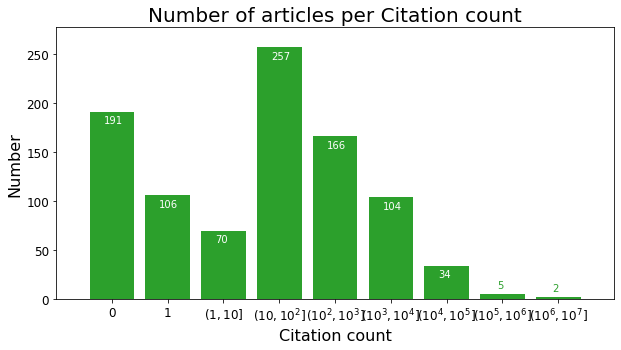

In [14]:
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
names = ["0", "1", r"$(1, 10]$", r"$(10, 10^2]$"] + [fr"$(10^{i+2}, 10^{i+3}]$" for i in range(5)]

top = 9
ys = [c for c in count if c>0]
ax.bar(names, ys, color="tab:green")

ax.tick_params(axis='x', rotation=0)

ax.set_xlabel("Citation count")
ax.set_ylabel("Number")
ax.set_title("Number of articles per Citation count", size=20);

ax.set_ylim(bottom=0, top=max(ys)+20);
ax.set_xlim(left=-1, right=top);

c = "white"
for x, y in enumerate(ys):
    if x < 7:
        plt.text(x = x-0.15,
        y = y-12,
        s = "{:.0f}".format(y),
        size=10,
        color = c)
    else:
        plt.text(x = x-0.1,
        y = y+6,
        s = "{:.0f}".format(y),
        size=10,
        color = "tab:green")

In [15]:
count_aff = {}
count_country = {}
for ix in df_scopus.index:
    row = df_scopus.loc[ix]
    affs = row["Affiliations"]
    if str(affs) != "nan":
        for x in affs.split("; "):
            if x not in count_aff:
                count_aff[x] = 0
            c = x.split(", ")[-1]
            if c not in count_country:
                count_country[c] = 0
            count_country[c] += 1 
            count_aff[x] += 1

In [16]:
df_aff = pd.DataFrame(count_aff.items(), columns="Affiliation count".split())
df_aff = df_aff.sort_values(["Affiliation"], ascending=True).sort_values(["count"], ascending=False)
df_aff

,Affiliation,count
50,"School of Sustainability, Arizona State University, Tempe, AZ, United States",9
1776,"Department of Continuing Education, University of Warwick, Coventry CV4 7AL, United Kingdom",5
1317,"University of Greenwich, United Kingdom",4
1448,"School of Education, University of Southampton, Southampton, United Kingdom",4
202,"Center for Global Sustainability and Cultural Transformation, Leuphana University of Lüneburg, Lüneburg, Germany",3
...,...,...
465,"Department of Socially Humanitarian Disciplines, Civil Aviation Academy, Almaty, Kazakhstan",1
464,"Department of Social and Humanitarian Disciplines, Kazakh Academy of Sports and Tourism, Almaty, Kazakhstan",1
1111,"Department of Social Technology, North-Caucasus Federal University, Stavropol, Russian Federation",1
76,"Department of Social Sciences, Universidad Loyola Andalucía, Sevilla, 41704, Spain",1


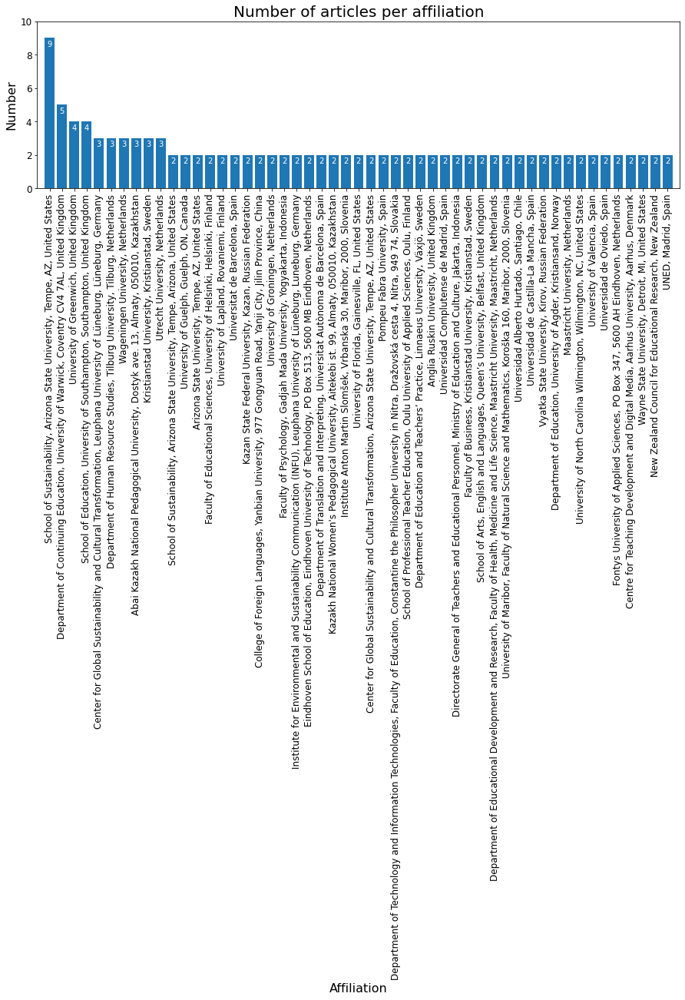

In [17]:
fig, ax = plt.subplots(1, 1, figsize=(15, 4))
top = 60-9
names = df_aff.iloc[:top]["Affiliation"]
names = [x if x not in rename else rename[x] for x in names]
ax.bar(names, df_aff.iloc[:top]["count"]);
ax.tick_params(axis='x', rotation=90)

ax.set_xlabel("Affiliation")
ax.set_ylabel("Number")
ax.set_title("Number of articles per affiliation", size=20);

ax.set_ylim(bottom=0, top=df_aff.iloc[:top]["count"].max()+1);
ax.set_xlim(left=-1, right=top);
for x, y in enumerate(df_aff.iloc[:top]["count"]):
        plt.text(x = x-0.2,
        y = y-0.5,
        s = "{:.0f}".format(y),
        size=10,
        color = "white")

In [18]:
df_coun = pd.DataFrame(count_country.items(), columns="Country count".split())
df_coun = df_coun.sort_values(["Country"], ascending=True).sort_values(["count"], ascending=False)
df_coun

,Country,count
5,Spain,220
13,United States,208
2,Netherlands,143
1,Germany,139
42,United Kingdom,110
...,...,...
96,Michigan Technological University,1
91,Montenegro,1
80,North Macedonia,1
97,Northeastern Illinois University,1


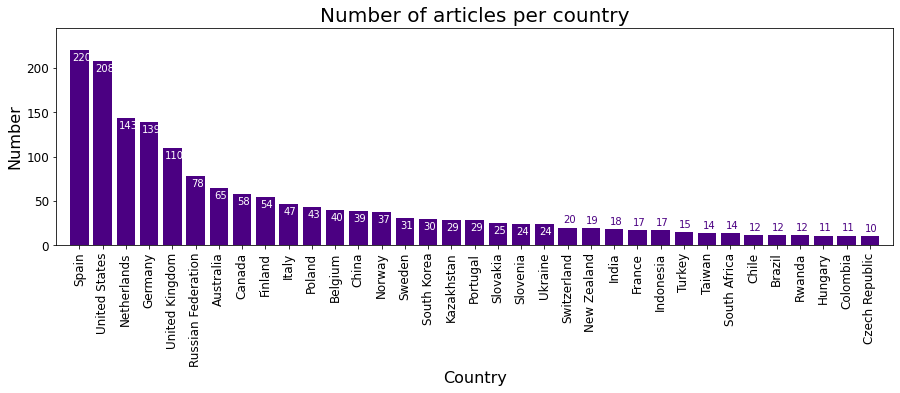

In [19]:
fig, ax = plt.subplots(1, 1, figsize=(15, 4))
top = 60-10-6-2-7
names = df_coun.iloc[:top]["Country"]
names = [x if x not in rename else rename[x] for x in names]
ax.bar(names, df_coun.iloc[:top]["count"], color="indigo");
ax.tick_params(axis='x', rotation=90)

ax.set_xlabel("Country")
ax.set_ylabel("Number")
ax.set_title("Number of articles per country", size=20);

ax.set_ylim(bottom=0, top=df_coun.iloc[:top]["count"].max()+25);
ax.set_xlim(left=-1, right=top);
for x, y in enumerate(df_coun.iloc[:top]["count"]):
    if x<5:
        plt.text(x = x-0.3,
        y = y-12,
        s = "{:.0f}".format(y),
        size=10,
        color = "white")
    elif x<30-9:
        plt.text(x = x-0.2,
        y = y-12,
        s = "{:.0f}".format(y),
        size=10,
        color = "white")
    else:
        plt.text(x = x-0.2,
        y = y+5,
        s = "{:.0f}".format(y),
        size=10,
        color = "indigo")

In [20]:
df_coun

,Country,count
5,Spain,220
13,United States,208
2,Netherlands,143
1,Germany,139
42,United Kingdom,110
...,...,...
96,Michigan Technological University,1
91,Montenegro,1
80,North Macedonia,1
97,Northeastern Illinois University,1


### Load (all-) direct citation network from json file generated by VOSviewer

**Parameters of VOSviewer**
* Method normalization: No normalization
* Layout: 
    * Attraction: 1
    * Repulsion: 0
* Clustering: 
    * Resolution: 0.001
    * Min. cluster size: 187
* Merge small clusters: Disable

In [21]:
all_network_items = read_network(
    file_path='complete_direct_citation_net_v2.json'
)

In [22]:
df_docs_outside = get_docs(
    all_network_items[all_network_items["cluster"].isna()], 
    df_scopus
)
df_docs_outside["cluster"] = 0
df_docs_outside.shape

(746, 18)

<img src="direct_citation_net.png"/>

* Apply LSA over (Others) nodes colored gray.

*obs: (Red) Dense component, (Gray) Others*

### Load (sub-) direct citation network from json file generated by VOSviewer

**Parameters of VOSviewer**
* Method normalization: Association strenght
* Layout: 
    * Attraction: 10
    * Repulsion: 1
* Clustering: 
    * Resolution: 0.05
    * Min. cluster size: 5

In [23]:
network_items = read_network(
    file_path='direct_citation_net_v2.json'
)

In [24]:
f = open("direct_citation_net_v2.json", encoding='utf-8-sig') # delete descripcion:
network = json.load(f)["network"]
network_links = network["links"] 
data_in_out_links = {}
for x in network_links:
    s, t = x["source_id"]-1, x["target_id"]-1
    if s not in data_in_out_links.keys():
        data_in_out_links[s] = {"inlinks": 0, "outlinks": 0}
    if t not in data_in_out_links.keys():
        data_in_out_links[t] = {"inlinks": 0, "outlinks": 0}
    data_in_out_links[s]["outlinks"] += 1
    data_in_out_links[t]["inlinks"] += 1

<img src="sub_direct_citation_net.png" with="500"/>

*obs: (Red) Cluster 1, (Green) Cluster 2, (Blue) Cluster 3*

<img src="sub_direct_citation_net_year.png" with="500"/>

## Exploratory data analysis

### Merge both files

In [25]:
df_docs = get_docs(
    network_items, # (sub-) direct citation network
    df_scopus      # Scopus bibliography
)

In [26]:
table_in_out_links = pd.DataFrame(data_in_out_links).T
table_in_out_links = table_in_out_links.loc[df_docs["id"].values]
table_in_out_links = table_in_out_links.reset_index().rename(columns={"index": "id"})
table_in_out_links

,id,inlinks,outlinks
0,0,0,4
1,7,0,5
2,17,0,1
3,18,0,5
4,19,0,6
...,...,...,...
184,906,2,0
185,908,1,0
186,911,1,0
187,924,1,0


### (all-) Direct citation network

Frecuencies

In [27]:
get_group_table(all_network_items)

,#Docs
Group,
Others,746
Dense component,189


In [28]:
all_network_items[all_network_items["Links"]>0]["cluster"].fillna(0).describe()

count    250.000000
mean     0.756000  
std      0.430354  
min      0.000000  
25%      1.000000  
50%      1.000000  
75%      1.000000  
max      1.000000  
Name: cluster, dtype: float64

In [29]:
746+189

935

Links

In [30]:
links = get_links_stats_table(all_network_items)
links

Links                                              
                   sum      mean       std  min  25%  50%  75%   max
Docs                                                                
All              874.0  0.934759  3.109876  0.0  0.0  0.0  1.0  55.0
Others           74.0   0.099196  0.356454  0.0  0.0  0.0  0.0  3.0 
Dense component  800.0  4.232804  5.817141  1.0  1.0  2.0  4.0  55.0

In [31]:
links["Unique edges"] = links[('Links',  'sum')]/2
links

Links                                                \
                   sum      mean       std  min  25%  50%  75%   max   
Docs                                                                   
All              874.0  0.934759  3.109876  0.0  0.0  0.0  1.0  55.0   
Others           74.0   0.099196  0.356454  0.0  0.0  0.0  0.0  3.0    
Dense component  800.0  4.232804  5.817141  1.0  1.0  2.0  4.0  55.0   

                Unique edges  
                              
Docs                          
All              437.0        
Others           37.0         
Dense component  400.0

### (sub-) Direct citation network

Plot frecuencies of clusters

In [32]:
plot_frec_clusters(df_docs)

In [33]:
table_links = get_top_table_clusters(df_docs, network_items, num_clusters=3, by="Links", min_val=0)
table_links

,Cluster,Year,Authors,Title,Links
187,1,1994,Hyland T.,Tilting at Windmills: The problems of challenging the National Council for Vocational Qualifications,1
186,1,1996,Bridges D.,Competence-based education and training: Progress or villainy?,1
184,1,1997,Hyland T.,Reconsidering Competence,2
183,1,1998,Hyland T.,Exporting Failure: The strange case of NVQs and overseas markets,2
173,1,2007,"Biesma R.G., Pavlova M., van Merode G.G., Groot W.",Using conjoint analysis to estimate employers preferences for key competencies of master level Dutch graduates entering the public health field,1
...,...,...,...,...,...
38,3,2021,"Wilson-Daily A.E., Feliu-Torruella M., Romero Serra M.",Key competencies: developing an instrument for assessing trainee teachers’ understanding and views,2
35,3,2021,"Tahirsylaj A., Fazliu F.",From Content- to Competence-Based Curricula–An Educational Account of Curriculum Policy in Kosovo,3
27,3,2021,"Guitert M., Romeu T., Baztán P.",The digital competence framework for primary and secondary schools in Europe,2
15,3,2022,"Xiang X., Chen Y., Fang Y., Zhang Q.",How Key Competencies Progress across School Terms? A Study of “Activities” in Geography Textbooks for Secondary Schools,2


Most cited papers per cluster

In [34]:
table_clusters = get_top_table_clusters(df_docs, network_items, num_clusters=3, by="Citations", min_val=0)
table_clusters["Links"] = table_links.loc[table_clusters.index]["Links"]
table_clusters["In-links"] = table_in_out_links.loc[table_clusters.index]["inlinks"]
table_clusters["Out-links"] = table_in_out_links.loc[table_clusters.index]["outlinks"]
table_clusters

,Cluster,Year,Authors,Title,Citations,Links,In-links,Out-links
187,1,1994,Hyland T.,Tilting at Windmills: The problems of challenging the National Council for Vocational Qualifications,6,1,1,0
186,1,1996,Bridges D.,Competence-based education and training: Progress or villainy?,18,1,1,0
184,1,1997,Hyland T.,Reconsidering Competence,56,2,2,0
183,1,1998,Hyland T.,Exporting Failure: The strange case of NVQs and overseas markets,10,2,0,2
173,1,2007,"Biesma R.G., Pavlova M., van Merode G.G., Groot W.",Using conjoint analysis to estimate employers preferences for key competencies of master level Dutch graduates entering the public health field,45,1,1,0
...,...,...,...,...,...,...,...,...
38,3,2021,"Wilson-Daily A.E., Feliu-Torruella M., Romero Serra M.",Key competencies: developing an instrument for assessing trainee teachers’ understanding and views,1,2,0,2
35,3,2021,"Tahirsylaj A., Fazliu F.",From Content- to Competence-Based Curricula–An Educational Account of Curriculum Policy in Kosovo,1,3,0,3
27,3,2021,"Guitert M., Romeu T., Baztán P.",The digital competence framework for primary and secondary schools in Europe,4,2,0,2
15,3,2022,"Xiang X., Chen Y., Fang Y., Zhang Q.",How Key Competencies Progress across School Terms? A Study of “Activities” in Geography Textbooks for Secondary Schools,0,2,0,2


In [35]:
pd.set_option('display.max_rows', None)

In [36]:
table_clusters[table_clusters["Cluster"] == 1].sort_values("Citations", ascending=False)

,Cluster,Year,Authors,Title,Citations,Links,In-links,Out-links
152,1,2011,"Wiek A., Withycombe L., Redman C.L.",Key competencies in sustainability: A reference framework for academic program development,1033,55,52,3
171,1,2007,"Barth M., Godemann J., Rieckmann M., Stoltenberg U.",Developing key competencies for sustainable development in higher education,548,28,28,0
144,1,2012,Rieckmann M.,Future-oriented higher education: Which key competencies should be fostered through university teaching and learning?,377,27,26,1
158,1,2010,"Brundiers K., Wiek A., Redman C.L.",Real-world learning opportunities in sustainability: from classroom into the real world,314,18,17,1
175,1,2007,"Baartman L.K.J., Bastiaens T.J., Kirschner P.A., van der Vleuten C.P.M.",Evaluating assessment quality in competence-based education: A qualitative comparison of two frameworks,151,11,11,0
143,1,2012,"Azevedo A., Apfelthaler G., Hurst D.",Competency development in business graduates: An industry-driven approach for examining the alignment of undergraduate business education with industry requirements,109,3,1,2
162,1,2009,"Mulder M., Gulikers J., Biemans H., Wesselink R.",The new competence concept in higher education: Error or enrichment?,96,8,7,1
43,1,2021,"Brundiers K., Barth M., Cebrián G., Cohen M., Diaz L., Doucette-Remington S., Dripps W., Habron G., Harré N., Jarchow M., Losch K., Michel J., Mochizuki Y., Rieckmann M., Parnell R., Walker P., Zint M.",Key competencies in sustainability in higher education—toward an agreed-upon reference framework,76,12,5,7
123,1,2013,"Remington-Doucette S.M., Connell K.Y.H., Armstrong C.M., Musgrove S.L.",Assessing sustainability education in a transdisciplinary undergraduate course focused on real-world problem solving: A case for disciplinary grounding,75,6,4,2
164,1,2009,"Zehrer A., Mössenlechner C.",Key competencies of tourism graduates: The employers' point of view,74,2,2,0


In [37]:
table_clusters[table_clusters["Cluster"] == 2].sort_values("Citations", ascending=False)

,Cluster,Year,Authors,Title,Citations,Links,In-links,Out-links
177,2,2004,"Biemans H., Nieuwenhuis L., Poell R., Mulder M., Wesselink R.",Competence-based vet in the netherlands: Background and pitfalls,169,26,26,0
153,2,2011,"De Bruijn E., Leeman Y.",Authentic and self-directed learning in vocational education: Challenges to vocational educators,100,10,8,2
174,2,2007,"Mulder M., Weigel T., Collins K.",The concept of competence in the development of vocational education and training in selected EU member states: A critical analysis,87,9,8,1
167,2,2009,"Biemans H., Wesselink R., Gulikers J., Schaafsma S., Verstegen J., Mulder M.",Towards competence-based VET: Dealing with the pitfalls,76,20,17,3
142,2,2012,"Malone K., Supri S.",A critical time for medical education: The perils of competence-based reform of the curriculum,60,2,2,0
157,2,2010,"Struyven K., De Meyst M.",Competence-based teacher education: Illusion or reality? An assessment of the implementation status in Flanders from teachers' and students' points of view,58,10,9,1
161,2,2010,"Wesselink R., de Jong C., Biemans H.J.A.",Aspects of competence-based education as footholds to improve the connectivity between learning in school and in the workplace,49,5,3,2
176,2,2004,Mansfield B.,Competence in transition,49,1,1,0
105,2,2015,"Koenen A.-K., Dochy F., Berghmans I.",A phenomenographic analysis of the implementation of competence-based education in higher education,48,13,5,8
156,2,2010,"Wesselink R., Dekker-Groen A.M., Biemans H.J.A., Mulder M.",Using an instrument to analyse competence-based study programmes: Experiences of teachers in dutch vocational education and training,37,16,14,2


In [38]:
table_clusters[table_clusters["Cluster"] == 3].sort_values("Citations", ascending=False)

,Cluster,Year,Authors,Title,Citations,Links,In-links,Out-links
150,3,2011,"Halász G., Michel A.","Key competences in Europe: Interpretation, policy formulation and implementation",122,4,3,1
149,3,2011,Pepper D.,Assessing key competences across the curriculum - and Europe,65,15,15,0
160,3,2010,"Hoskins B., Crick R.",Competences for learning to learn and active citizenship: Different currencies or two sides of the same coin?,55,4,4,0
116,3,2014,Caena F.,Teacher competence frameworks Europe: Policy-as-discourse and policy-as-practice,51,1,1,0
170,3,2007,Schleicher A.,Can competencies assessed by PISA be considered the fundamental school knowledge 15-year-olds should possess?,47,1,1,0
148,3,2011,"Tiana A., Moya J., Luengo F.",Implementing key competences in basic education: Reflections on curriculum design and development in spain,35,10,10,0
172,3,2007,Moon Y.-L.,Education reform and competency-based education,30,2,2,0
129,3,2013,"Valle J., Manso J.",Key competences as a trend in the supranational educational policies of the european union [Competencias clave como tendencia de la política educative supranacional de la Unión Europea],25,3,3,0
128,3,2013,Takayama K.,"OECD, 'Key competencies' and the new challenges of educational inequality",25,4,3,1
147,3,2011,"Dabrowski M., Wiśniewski J.",Translating key competences into the school curriculum: Lessons from the Polish experience,20,8,8,0


### (all-) Direct citation network



Histogram of number of docs per year

In [39]:
plot_docs_per_year(df_scopus)

In [40]:
df_scopus_net = df_scopus.merge(network_items[["id", "cluster"]], on="id", how="outer")
df_scopus_net["cluster"] = df_scopus_net["cluster"].fillna("other").astype(str)

In [41]:
df_scopus_net["cluster"].value_counts().iloc[1:]

1.0    89
2.0    57
3.0    43
Name: cluster, dtype: int64

In [42]:
    fig = px.histogram(df_scopus_net, x="Year", color="cluster")
    fig.update_layout(
        title="Histogram of #Docs per year",
        barmode="stack"
    )
    fig.show(renderer="notebook")

In [43]:
    frec_sources = pd.DataFrame(df_scopus_net[df_scopus_net["cluster"] == "1.0"]["Publisher"].value_counts())
    frec_sources = frec_sources.reset_index().iloc[:25,:]
    frec_sources = frec_sources.rename(columns={"index": "Publisher", "Publisher": "#Docs"})
    fig = px.bar(frec_sources, x="Publisher", y="#Docs", text_auto=True)
    fig.update_layout(
        title="Histogram of #Docs per publisher"
    )
    fig.show(renderer="notebook")

In [44]:
    frec_sources = pd.DataFrame(df_scopus_net[df_scopus_net["cluster"] == "2.0"]["Publisher"].value_counts())
    frec_sources = frec_sources.reset_index().iloc[:25,:]
    frec_sources = frec_sources.rename(columns={"index": "Publisher", "Publisher": "#Docs"})
    fig = px.bar(frec_sources, x="Publisher", y="#Docs", text_auto=True)
    fig.update_layout(
        title="Histogram of #Docs per publisher"
    )
    fig.show(renderer="notebook")

In [45]:
    frec_sources = pd.DataFrame(df_scopus_net[df_scopus_net["cluster"] == "3.0"]["Publisher"].value_counts())
    frec_sources = frec_sources.reset_index().iloc[:25,:]
    frec_sources = frec_sources.rename(columns={"index": "Publisher", "Publisher": "#Docs"})
    fig = px.bar(frec_sources, x="Publisher", y="#Docs", text_auto=True)
    fig.update_layout(
        title="Histogram of #Docs per publisher"
    )
    fig.show(renderer="notebook")

Histogram of number of docs per source (Top 25)

In [46]:
plot_docs_per_source(df_scopus)

---
# Latent semantic analysis (LSA) per cluster

## Preprocess data

Add preprocessing of data

In [47]:
%%time
add_preprocess(df_docs)

Wall time: 4.88 s


In [48]:
%%time
add_preprocess(df_docs_outside)

Wall time: 18.2 s


<AxesSubplot:ylabel='Density'>

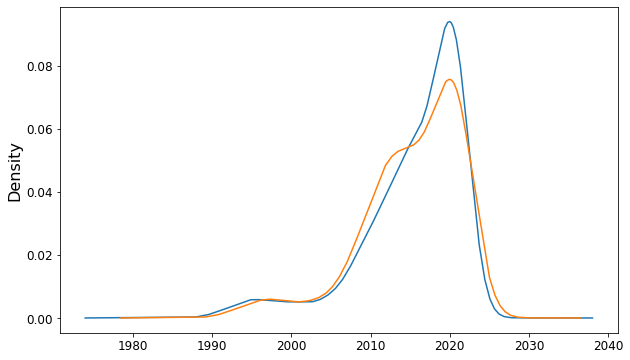

In [49]:
df_docs_outside["Year"].plot.density()
df_docs["Year"].plot.density()

<AxesSubplot:>

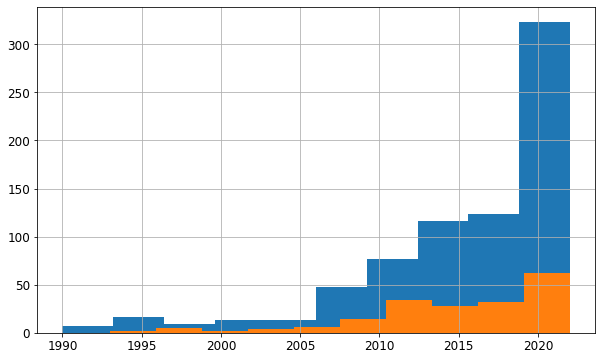

In [50]:
df_docs_outside["Year"].hist()
df_docs["Year"].hist()


In [51]:
# df_docs[(df_docs["cluster"] == 3)&(df_docs["Year"]>=2020)].shape#

## LSA per cluster

### Outside

In [52]:
LSA_0 = LSA(
    df_docs_outside, 
    cluster_id=0, 
    num_topics=6
)

In [53]:
plot_top_eigenvalues(LSA_0, cluster_id=0, k=30)

In [54]:
#     num_std_u, num_std_v = 1, 1
#     lsa=LSA_1
#     abs_u = abs(lsa["lsi"].projection.u)
#     tresh_u = np.mean(abs_u, axis=0) + num_std_u * np.std(abs_u, axis=0)

#     index_u_per_factor = np.where(abs_u>tresh_u)
#     term_per_factor = csr_matrix(
#         (
#             abs_u[index_u_per_factor[0], index_u_per_factor[1]], 
#             (index_u_per_factor[0], index_u_per_factor[1])
#         ), 
#         shape=abs_u.shape
#     )

#     num_terms = int(lsa["lsi"].num_terms)
#     num_docs = int(lsa["lsi"].docs_processed)
#     corpus_csc = corpus2csc(lsa["corpus_tfidf"], num_terms=num_terms, num_docs=num_docs)
    
#     sigma = lsa["lsi"].projection.s
#     sigma_1 = 1/sigma
#     Sigma_1 = np.diag(sigma_1)
    
#     doc_per_factor = (corpus_csc.T @ term_per_factor) @ Sigma_1
#     doc_per_factor = doc_per_factor / np.array([np.sum(doc_per_factor, axis=1)]).T 
#     doc_per_factor = np.asarray(doc_per_factor)

#     tresh_v = np.mean(doc_per_factor, axis=0) + num_std_v * np.std(doc_per_factor, axis=0)
#     index_v_per_factor = np.where(doc_per_factor>tresh_v)

In [55]:
# o = pd.DataFrame(doc_per_factor)
# o[0].hist()
# plt.vlines(tresh_v[0], 0, 25, color="red")

In [56]:
# o = pd.DataFrame(abs_u)
# o[0].hist(bins=100)
# plt.vlines(tresh_u[0], 0, 3000, color="red")

In [57]:
topics_0 = get_topics(LSA_0)

In [58]:
topics_0.keys()

dict_keys(['rel_term_per_factor', 'term_per_factor', 'doc_per_factor', 'index_per_factor'])

Plor frecuencies of topics

In [59]:
table_hist_per_topic_0 = get_table_hist_per_topic(topics_0["index_per_factor"])

In [60]:
table_hist_per_topic_0

,Topic,#Docs,#Terms
0,0,121,2501
1,1,110,2923
5,2,81,3339
4,3,84,3795
2,4,99,3371
3,5,95,3491


In [61]:
plot_topics(table_hist_per_topic_0, cluster_id=0, by="Docs")

In [62]:
plot_topics(table_hist_per_topic_0, cluster_id=0, by="Terms")

Plot strength words per topic

In [63]:
strengths_0 = get_strengths(LSA_0, topics_0["rel_term_per_factor"], num_terms=15)

In [64]:
plot_strength_term_per_topic(strengths_0, cluster_id=0)

In [65]:
o = get_terms_table(
    table_hist_per_topic_0, 
    strengths_0
)
o

,Top 15 terms,#Terms,#Docs
Topic,,,
0,"teacher, student, digital, learning, medical, competence, training, school, curriculum, competency, skill, learn, education, assessment, professional",2501,121
1,"medical, digital, clinical, digital competence, health, medical student, teacher, patient, medical education, dental, care, clinical competence, language, human, literacy",2923,110
2,"digital, digital competence, medical, clinical, sustainable, sustainable development, literacy, health, teacher, medical student, medium, digital literacy, student, medical education, project",3339,81
3,"translation, sustainable, sustainable development, translator, language, translator training, assessment, engineering, education sustainable, portfolio, foreign language, engineer, foreign, translation competence, training",3795,84
4,"translation, teacher, translator, sustainable, language, sustainable development, digital, translator training, school, foreign language, foreign, intercultural, training, english, assessment",3371,99
5,"language, vocational, teacher, foreign language, intercultural, foreign, sustainable, sustainable development, education training, vocational education, national vocational, curriculum, competence base, training, vocational qualification",3491,95


In [66]:
weighted_cluster_0 = get_weighted_cluster(LSA_0["df_cluster"], topics_0["index_per_factor"], topics_0["doc_per_factor"])

In [67]:
plot_strength_doc_per_topic(weighted_cluster_0, cluster_id=0)

In [68]:
citation_table = get_top_table_topics(weighted_cluster_0, num_topics=6, by="Citations", min_val=1)
# links_table = get_top_table_topics(weighted_cluster_0, num_topics=6, by="Links", min_val=0)
# citation_table["Links"] = links_table["Links"]
citation_table

,Topic,Strenght,Year,Authors,Title,Citations
733,0,0.270898,1995,Lasserre P.,Corporate strategies for the Asia Pacific region,13
726,0,0.255608,1996,Drake B.,Consumer and worker perceptions of key child welfare competencies,25
717,0,0.246197,1998,Horder W.,Competence(s) without tears?,4
709,0,0.269079,2000,Guinn S.L.,Succession planning without job titles,5
705,0,0.251058,2001,"Barsky A., Coleman H.",Evaluating skill acquisition in motivational interviewing: The development of an instrument to measure practice skills,25
697,0,0.292970,2004,"Evans K., Kersh N.",Recognition of tacit skills and knowledge: Sustaining learning outcomes in workplace environments,28
691,0,0.264524,2005,Williams C.,The discursive construction of the 'competent' learner-worker: From key competencies to 'employability skills',29
690,0,0.259372,2005,Abu Bakar A.B.,IT competencies in academic libraries: The Malaysian experience,14
688,0,0.263335,2005,Walat W.,General model of technology education in Polish school system,1
687,0,0.252665,2006,"Diepstraten I., Du Bois-Reymond M., Vinken H.",Trendsetting learning biographies: Concepts of navigating through late-modern life and learning,17


In [69]:
list(LSA_0["df_cluster"]["label"])

['benson s. (2022)',
 'pearce b.b.j. (2022)',
 'janssens o. (2022)',
 'franz a. (2022)',
 'bransen d. (2022)',
 'basilotta-gómez-pablos v. (2022)',
 'chen c.-h. (2022)',
 'swan k. (2022)',
 'zhang s. (2022)',
 'barrachina-peris j. (2022)',
 'altavilla g. (2022)',
 'fang y. (2022)',
 'fernández-morante c. (2022)',
 'liu h. (2022)',
 'meirbekov a. (2022)',
 'metsäpelto r.-l. (2022)',
 'khandelwal r. (2022)',
 'vidal-meliá l. (2022)',
 'moonen-van loon j.m.w. (2022)',
 'due c. (2022)',
 'den hertog r. (2022)',
 'vazquez-marin p. (2022)',
 'kostorz k. (2022)',
 'li j. (2022)',
 'espigares-pinazo m.j. (2022)',
 'anonymous (2022)',
 'beizerau u. (2022)',
 'kalykbayeva a. (2022)',
 'cayuela l. (2022)',
 'martínez-bravo m.c. (2022)',
 'newman d.s. (2022)',
 'urbancová h. (2022)',
 'flägel k. (2022)',
 'solikhah i. (2022)',
 'caballero-cobos m. (2022)',
 'brymer e. (2022)',
 'lupión-cobos t. (2022)',
 'mushi c. (2022)',
 'kanaki k. (2022)',
 'giaffredo s. (2022)',
 'kamandhari h.h. (2022)',
 'u

In [70]:
display_topics(
    lsa = LSA_0,
    topics = topics_0,
    label = 'benson s. (2022)'
)

In [71]:
import pickle

In [72]:
pickle.dump(df_docs_outside, open("df_docs_outside.pickle", "wb"))

## Clusters (dense component)

**Number of topics per cluster**

*Criteria*: Elbow of eigenvalues

* Cluster 1: 5
* Cluster 2: 5
* Cluster 3: 5

In [73]:
num_topics_per_cluster = {
    1: 6, 
    2: 6, 
    3: 6
}

### Cluster 1

In [74]:
LSA_1 = LSA(
    df_docs, 
    cluster_id=1, 
    num_topics=num_topics_per_cluster[1]
)

In [75]:
plot_top_eigenvalues(LSA_1, cluster_id=1, k=30)

In [76]:
    abs_u = abs(lsa["lsi"].projection.u)
    tresh_u = np.mean(abs_u, axis=0) + num_std_u * np.std(abs_u, axis=0)

NameError: name 'lsa' is not defined

In [ ]:
topics_1 = get_topics(LSA_1)

In [ ]:
topics_1.keys()

Plor frecuencies of topics

In [ ]:
table_hist_per_topic_1 = get_table_hist_per_topic(topics_1["index_per_factor"])

In [ ]:
table_hist_per_topic_1

In [ ]:
plot_topics(table_hist_per_topic_1, cluster_id=1, by="Docs")

In [ ]:
plot_topics(table_hist_per_topic_1, cluster_id=1, by="Terms")

Plot strength words per topic

In [ ]:
strengths_1 = get_strengths(LSA_1, topics_1["rel_term_per_factor"], num_terms=15)

In [ ]:
plot_strength_term_per_topic(strengths_1, cluster_id=1)

In [ ]:
o = get_terms_table(
    table_hist_per_topic_1, 
    strengths_1
)
o

In [ ]:
weighted_cluster_1 = get_weighted_cluster(LSA_1["df_cluster"], topics_1["index_per_factor"], topics_1["doc_per_factor"])

In [ ]:
plot_strength_doc_per_topic(weighted_cluster_1, cluster_id=1)

In [ ]:
citation_table = get_top_table_topics(weighted_cluster_1, num_topics=6, by="Citations", min_val=0)
links_table = get_top_table_topics(weighted_cluster_1, num_topics=6, by="Links", min_val=0)
citation_table["Links"] = links_table["Links"]
citation_table_1 = citation_table
citation_table_1

In [ ]:
list(LSA_1["df_cluster"]["label"])

In [ ]:
display_topics(
    lsa = LSA_1,
    topics = topics_1,
    label = 'zwolińska k. (2022)'
)

In [ ]:
pickle.dump(weighted_cluster_1, open("weighted_cluster_1.pickle", "wb"))

In [ ]:
topics_outside_1 = get_topics_outside(df_docs_outside, topics_1, LSA_1)

In [ ]:
table_hist_per_topic_1_outside = get_table_hist_per_topic(topics_outside_1["index_per_factor"])
table_hist_per_topic_1_outside

In [ ]:
plot_topics(table_hist_per_topic_1_outside, cluster_id=1, by="Docs")

In [ ]:
weighted_cluster_1_outside = get_weighted_cluster(df_docs_outside, topics_outside_1["index_per_factor"], topics_outside_1["doc_outside_per_factor"])

In [ ]:
plot_strength_doc_per_topic(weighted_cluster_1_outside, cluster_id=1)

In [ ]:
citation_table = get_top_table_topics(weighted_cluster_1_outside, num_topics=6, by="Citations", min_val=0)
links_table = get_top_table_topics(weighted_cluster_1_outside, num_topics=6, by="Links", min_val=0)
citation_table["Links"] = links_table["Links"]
citation_table_outside_1 = citation_table
citation_table_outside_1

In [ ]:
min_y,  max_y = min(df_docs["Year"].min(), df_docs_outside["Year"].min()), max(df_docs["Year"].max(), df_docs_outside["Year"].max())
min_y, max_y

In [ ]:
def get_table_serie(df, min_y, max_y, i=0):
    table_ = df.groupby(["Topic", "Year"]).apply(lambda x: x.shape[0]).reset_index()
    table_ = table_[table_["Topic"] == str(i)]
    table_ = table_.drop(columns=["Topic"])
    table_ = table_.rename(columns={0: "#Docs"})
    fill_col = pd.DataFrame([range(min_y, max_y+1)], index=["Year"]).T
    fill_col["#Docs"] = 0
    table_ = pd.concat([table_, fill_col], ignore_index=True).drop_duplicates("Year")
    table_ = table_.sort_values("Year")
    table_ = table_.reset_index().drop(columns="index")
    return table_

In [ ]:
num_topics=6
color_map = {
    t: px.colors.qualitative.Plotly[t]
    for t in range(num_topics)
}
color_map = {**color_map, **{-1: "gray"}}

In [ ]:
for topic_i in range(6):
    table_serie_outside_1 =  get_table_serie(citation_table_outside_1, min_y, max_y, i=topic_i)
#     plt.plot(table_serie_outside_1["Year"], np.cumsum(table_serie_outside_1["#Docs"]), '--', c=color_map[topic_i])

    table_serie_1 =  get_table_serie(citation_table_1, min_y, max_y, i=topic_i)
    plt.plot(table_serie_1["Year"], np.cumsum(table_serie_1["#Docs"]), '--', c=color_map[topic_i])

    table_serie_both_1 = table_serie_outside_1.copy()
    table_serie_both_1["#Docs"] = table_serie_both_1["#Docs"] + table_serie_1["#Docs"]

    plt.plot(table_serie_both_1["Year"], np.cumsum(table_serie_both_1["#Docs"]), '.-', c=color_map[topic_i], label=f"topic_{topic_i}")
plt.legend();
plt.title("Cluster 1")


### Cluster 2

In [ ]:
LSA_2 = LSA(
    df_docs, 
    cluster_id=2, 
    num_topics=num_topics_per_cluster[2]
)

In [ ]:
plot_top_eigenvalues(LSA_2, cluster_id=2, k=30)

Plor frecuencies of topics

In [ ]:
LSA_2["lsi"].id2word.token2id["self_efficacy"]

In [ ]:
LSA_2["lsi"].projection.u[848] 

In [ ]:
abs_u = abs(LSA_2["lsi"].projection.u)
num_std_u=1
tresh_u = np.mean(abs_u, axis=0) + num_std_u * np.std(abs_u, axis=0)
tresh_u

In [ ]:
topics_2 = get_topics(LSA_2)

In [ ]:
table_hist_per_topic_2 = get_table_hist_per_topic(topics_2["index_per_factor"])

In [ ]:
plot_topics(table_hist_per_topic_2, cluster_id=2, by="Docs")

In [ ]:
plot_topics(table_hist_per_topic_2, cluster_id=2, by="Terms")

Plot strength words per topic

In [ ]:
strengths_2 = get_strengths(LSA_2, topics_2["rel_term_per_factor"], num_terms=15)

In [ ]:
plot_strength_term_per_topic(strengths_2, cluster_id=2)

In [ ]:
get_terms_table(
    table_hist_per_topic_2, 
    strengths_2
)

In [ ]:
weighted_cluster_2 = get_weighted_cluster(LSA_2["df_cluster"], topics_2["index_per_factor"], topics_2["doc_per_factor"])

In [ ]:
plot_strength_doc_per_topic(weighted_cluster_2, cluster_id=2)

In [ ]:
citation_table = get_top_table_topics(weighted_cluster_2, num_topics=6, by="Citations", min_val=0)
links_table = get_top_table_topics(weighted_cluster_2, num_topics=6, by="Links", min_val=0)
citation_table["Links"] = links_table["Links"]
citation_table_2 = citation_table
citation_table_2

In [ ]:
list(LSA_2["df_cluster"]["label"])

In [ ]:
np.array(list(LSA_2["df_cluster"]["label"]))[citation_table_2[citation_table_2["Topic"] == "0"].index.values]

In [ ]:
display_topics(
    lsa = LSA_2,
    topics = topics_2,
    label = 'brauer s. (2021)'
)

In [ ]:
pickle.dump(weighted_cluster_2, open("weighted_cluster_2.pickle", "wb"))

In [ ]:
topics_outside_2 = get_topics_outside(df_docs_outside, topics_2, LSA_2)

In [ ]:
table_hist_per_topic_2_outside = get_table_hist_per_topic(topics_outside_2["index_per_factor"])
table_hist_per_topic_2_outside

In [ ]:
plot_topics(table_hist_per_topic_2_outside, cluster_id=2, by="Docs")

In [ ]:
weighted_cluster_2_outside = get_weighted_cluster(df_docs_outside, topics_outside_2["index_per_factor"], topics_outside_1["doc_outside_per_factor"])

In [ ]:
plot_strength_doc_per_topic(weighted_cluster_2_outside, cluster_id=2)

In [ ]:
citation_table = get_top_table_topics(weighted_cluster_2_outside, num_topics=6, by="Citations", min_val=0)
links_table = get_top_table_topics(weighted_cluster_2_outside, num_topics=6, by="Links", min_val=0)
citation_table["Links"] = links_table["Links"]
citation_table_outside_2 = citation_table
citation_table_outside_2

In [ ]:
for topic_i in range(6):
    table_serie_outside_2 =  get_table_serie(citation_table_outside_2, min_y, max_y, i=topic_i)
#     plt.plot(table_serie_outside_1["Year"], np.cumsum(table_serie_outside_1["#Docs"]), '--', c=color_map[topic_i])

    table_serie_2 =  get_table_serie(citation_table_2, min_y, max_y, i=topic_i)
    plt.plot(table_serie_2["Year"], np.cumsum(table_serie_2["#Docs"]), '--', c=color_map[topic_i])

    table_serie_both_2 = table_serie_outside_2.copy()
    table_serie_both_2["#Docs"] = table_serie_both_2["#Docs"] + table_serie_2["#Docs"]

    plt.plot(table_serie_both_2["Year"], np.cumsum(table_serie_both_2["#Docs"]), '.-', c=color_map[topic_i], label=f"topic_{topic_i}")
plt.legend();
plt.title("Cluster 2")


### Cluster 3

In [ ]:
LSA_3 = LSA(
    df_docs, 
    cluster_id=3, 
    num_topics=num_topics_per_cluster[3]
)

In [ ]:
plot_top_eigenvalues(LSA_3, cluster_id=3, k=30)

Plot frecuencies of topics

In [ ]:
topics_3 = get_topics(LSA_3)

In [ ]:
table_hist_per_topic_3 = get_table_hist_per_topic(topics_3["index_per_factor"])

In [ ]:
plot_topics(table_hist_per_topic_3, cluster_id=3, by="Docs")

In [ ]:
plot_topics(table_hist_per_topic_3, cluster_id=3, by="Terms")

Plot strength words per topic

In [ ]:
strengths_3 = get_strengths(LSA_3, topics_3["rel_term_per_factor"], num_terms=15)

In [ ]:
plot_strength_term_per_topic(strengths_3, cluster_id=3)

In [ ]:
get_terms_table(
    table_hist_per_topic_3, 
    strengths_3
)

In [ ]:
weighted_cluster_3 = get_weighted_cluster(LSA_3["df_cluster"], topics_3["index_per_factor"], topics_3["doc_per_factor"])

In [ ]:
plot_strength_doc_per_topic(weighted_cluster_3, cluster_id=3)

In [ ]:
citation_table = get_top_table_topics(weighted_cluster_3, num_topics=6, by="Citations", min_val=0)
links_table = get_top_table_topics(weighted_cluster_3, num_topics=6, by="Links", min_val=0)
citation_table["Links"] = links_table["Links"]
citation_table_3 = citation_table
citation_table_3

In [ ]:
list(LSA_3["df_cluster"]["label"])

In [ ]:
display_topics(
    lsa = LSA_3,
    topics = topics_3,
    label = 'thompson t. (2001)'
)

In [ ]:
pickle.dump(weighted_cluster_3, open("weighted_cluster_3.pickle", "wb"))

In [ ]:
topics_outside_3 = get_topics_outside(df_docs_outside, topics_3, LSA_3)

In [ ]:
table_hist_per_topic_3_outside = get_table_hist_per_topic(topics_outside_3["index_per_factor"])
table_hist_per_topic_3_outside

In [ ]:
plot_topics(table_hist_per_topic_3_outside, cluster_id=3, by="Docs")

In [ ]:
weighted_cluster_3_outside = get_weighted_cluster(df_docs_outside, topics_outside_3["index_per_factor"], topics_outside_1["doc_outside_per_factor"])

In [ ]:
plot_strength_doc_per_topic(weighted_cluster_3_outside, cluster_id=3)

In [ ]:
citation_table = get_top_table_topics(weighted_cluster_3_outside, num_topics=6, by="Citations", min_val=0)
links_table = get_top_table_topics(weighted_cluster_3_outside, num_topics=6, by="Links", min_val=0)
citation_table["Links"] = links_table["Links"]
citation_table_outside_3 = citation_table
citation_table_outside_3

In [ ]:
for topic_i in range(6):
    table_serie_outside_3 =  get_table_serie(citation_table_outside_3, min_y, max_y, i=topic_i)
#     plt.plot(table_serie_outside_1["Year"], np.cumsum(table_serie_outside_1["#Docs"]), '--', c=color_map[topic_i])

    table_serie_3 =  get_table_serie(citation_table_3, min_y, max_y, i=topic_i)
    plt.plot(table_serie_3["Year"], np.cumsum(table_serie_3["#Docs"]), '--', c=color_map[topic_i])

    table_serie_both_3 = table_serie_outside_3.copy()
    table_serie_both_3["#Docs"] = table_serie_both_3["#Docs"] + table_serie_3["#Docs"]

    plt.plot(table_serie_both_3["Year"], np.cumsum(table_serie_both_3["#Docs"]), '.-', c=color_map[topic_i], label=f"topic_{topic_i}")
plt.legend();
plt.title("Cluster 3")


### Cluster "all"

In [ ]:
LSA_all = LSA(
    df_docs, 
    cluster_id="all", 
    num_topics=6
)

In [ ]:
plot_top_eigenvalues(LSA_all, cluster_id="all", k=30)

In [ ]:
topics_all = get_topics(LSA_all)

In [ ]:
topics_all.keys()

Plor frecuencies of topics

In [ ]:
table_hist_per_topic_all = get_table_hist_per_topic(topics_all["index_per_factor"])

In [ ]:
table_hist_per_topic_all

In [ ]:
plot_topics(table_hist_per_topic_all, cluster_id="all", by="Docs")

In [ ]:
plot_topics(table_hist_per_topic_all, cluster_id="all", by="Terms")

Plot strength words per topic

In [ ]:
strengths_all = get_strengths(LSA_all, topics_all["rel_term_per_factor"], num_terms=15)

In [ ]:
plot_strength_term_per_topic(strengths_all, cluster_id="all")

In [ ]:
o = get_terms_table(
    table_hist_per_topic_all, 
    strengths_all
)
o

In [ ]:
weighted_cluster_all = get_weighted_cluster(LSA_all["df_cluster"], topics_all["index_per_factor"], topics_all["doc_per_factor"])

In [ ]:
plot_strength_doc_per_topic(weighted_cluster_all, cluster_id="all")

In [ ]:
# num_clusters = 4
# table = []
# for cluster_id in range(1, 3+1):
#     o = weighted_cluster_all[weighted_cluster_all["cluster"] == cluster_id]
#     for i in range(num_clusters):
#         col = f"topic_{i}"
#         val = (o[col]>0).sum()
#         table.append({"cluster": str(cluster_id), "col": col, "frec": val})

# df_table = pd.DataFrame(table)
# fig = px.bar(
#         df_table, 
#         x="cluster", 
#         y="frec", 
# #         title=f"Top {k} eigenvalues (Cluster {cluster_id})"
#         color="col",
#         barmode='group'
#     )
# fig.show(renderer="notebook")

In [ ]:
citation_table_all = get_top_table_topics(weighted_cluster_all, num_topics=6, by="Citations", min_val=0)
citation_table_all

In [ ]:
topics_outside_all = get_topics_outside(df_docs_outside, topics_all, LSA_all)

In [ ]:
table_hist_per_topic_all_outside = get_table_hist_per_topic(topics_outside_all["index_per_factor"])
table_hist_per_topic_all_outside

In [ ]:
plot_topics(table_hist_per_topic_all_outside, cluster_id="all", by="Docs")

In [ ]:
weighted_cluster_all_outside = get_weighted_cluster(df_docs_outside, topics_outside_all["index_per_factor"], topics_outside_all["doc_outside_per_factor"])

In [ ]:
plot_strength_doc_per_topic(weighted_cluster_all_outside, cluster_id="all")

In [ ]:
citation_table = get_top_table_topics(weighted_cluster_all_outside, num_topics=6, by="Citations", min_val=0)
links_table = get_top_table_topics(weighted_cluster_all_outside, num_topics=6, by="Links", min_val=0)
citation_table["Links"] = links_table["Links"]
citation_table_outside_all = citation_table
citation_table_outside_all

In [ ]:
for topic_i in range(6):
    table_serie_outside_all =  get_table_serie(citation_table_outside_all, min_y, max_y, i=topic_i)
#     plt.plot(table_serie_outside_1["Year"], np.cumsum(table_serie_outside_1["#Docs"]), '--', c=color_map[topic_i])

    table_serie_all =  get_table_serie(citation_table_all, min_y, max_y, i=topic_i)
    plt.plot(table_serie_all["Year"], np.cumsum(table_serie_all["#Docs"]), '--', c=color_map[topic_i])

    table_serie_both_all = table_serie_outside_all.copy()
    table_serie_both_all["#Docs"] = table_serie_both_all["#Docs"] + table_serie_all["#Docs"]

    plt.plot(table_serie_both_all["Year"], np.cumsum(table_serie_both_all["#Docs"]), '.-', c=color_map[topic_i], label=f"topic_{topic_i}")
plt.legend();
plt.title("Cluster all")



In [ ]:
list(LSA_all["df_cluster"]["label"])

In [ ]:
display_topics(
    lsa = LSA_all,
    topics = topics_all,
    label = 'foot s. (1996)'
)

## All data

In [ ]:
df_all_docs = pd.concat([df_docs_outside, df_docs])
df_all_docs["cluster"] = 0
df_all_docs["cluster"].value_counts()

In [ ]:
LSA_data = LSA(
    df_all_docs, 
    cluster_id="all", 
    num_topics=6
)

In [ ]:
plot_top_eigenvalues(LSA_data, cluster_id="data", k=30)

In [ ]:
topics_data = get_topics(LSA_data)

In [ ]:
topics_data.keys()

Plor frecuencies of topics

In [ ]:
table_hist_per_topic_data = get_table_hist_per_topic(topics_data["index_per_factor"])

In [ ]:
table_hist_per_topic_data

In [ ]:
plot_topics(table_hist_per_topic_data, cluster_id="data", by="Docs")

In [ ]:
plot_topics(table_hist_per_topic_data, cluster_id="data", by="Terms")

Plot strength words per topic

In [ ]:
strengths_data = get_strengths(LSA_data, topics_all["rel_term_per_factor"], num_terms=15)

In [ ]:
plot_strength_term_per_topic(strengths_data, cluster_id="data")

In [ ]:
o = get_terms_table(
    table_hist_per_topic_data, 
    strengths_data
)
o

In [ ]:
weighted_cluster_data = get_weighted_cluster(LSA_data["df_cluster"], topics_data["index_per_factor"], topics_data["doc_per_factor"])

In [ ]:
plot_strength_doc_per_topic(weighted_cluster_data, cluster_id="data")

In [ ]:
# num_clusters = 4
# table = []
# for cluster_id in range(1, 3+1):
#     o = weighted_cluster_all[weighted_cluster_all["cluster"] == cluster_id]
#     for i in range(num_clusters):
#         col = f"topic_{i}"
#         val = (o[col]>0).sum()
#         table.append({"cluster": str(cluster_id), "col": col, "frec": val})

# df_table = pd.DataFrame(table)
# fig = px.bar(
#         df_table, 
#         x="cluster", 
#         y="frec", 
# #         title=f"Top {k} eigenvalues (Cluster {cluster_id})"
#         color="col",
#         barmode='group'
#     )
# fig.show(renderer="notebook")

In [ ]:
citation_table_data = get_top_table_topics(weighted_cluster_data, num_topics=6, by="Citations", min_val=0)
citation_table_data

In [ ]:
topics_outside_data = get_topics_outside(df_docs_outside, topics_data, LSA_data)

In [ ]:
table_hist_per_topic_data_outside = get_table_hist_per_topic(topics_outside_data["index_per_factor"])
table_hist_per_topic_data_outside

In [ ]:
plot_topics(table_hist_per_topic_data_outside, cluster_id="data", by="Docs")

In [ ]:
weighted_cluster_data_outside = get_weighted_cluster(df_docs_outside, topics_outside_data["index_per_factor"], topics_outside_data["doc_outside_per_factor"])

In [ ]:
plot_strength_doc_per_topic(weighted_cluster_data_outside, cluster_id="data")

In [ ]:
citation_table = get_top_table_topics(weighted_cluster_data_outside, num_topics=6, by="Citations", min_val=0)
links_table = get_top_table_topics(weighted_cluster_data_outside, num_topics=6, by="Links", min_val=0)
citation_table["Links"] = links_table["Links"]
citation_table_outside_data = citation_table
citation_table_outside_data

In [ ]:
for topic_i in range(6):
    table_serie_outside_data =  get_table_serie(citation_table_outside_data, min_y, max_y, i=topic_i)

    table_serie_data =  get_table_serie(citation_table_data, min_y, max_y, i=topic_i)

    table_serie_inside_data = table_serie_data.copy()
    table_serie_inside_data["#Docs"] = table_serie_inside_data["#Docs"] - table_serie_outside_data["#Docs"]

    plt.plot(table_serie_inside_data["Year"], np.cumsum(table_serie_inside_data["#Docs"]), '--', c=color_map[topic_i])
    plt.plot(table_serie_data["Year"], np.cumsum(table_serie_data["#Docs"]), '.-', c=color_map[topic_i], label=f"topic_{topic_i}")
plt.legend();
plt.title("All data")



## Other tests

In [ ]:
file_path='direct_citation_net_v2.json'
f = open(file_path, encoding='utf-8-sig') # delete descripcion:
network = json.load(f)["network"]
edges = [(e["source_id"], e["target_id"]) for e in network["links"]]

In [ ]:
node_pos = {weighted_cluster_1.loc[ix]["id"]: (weighted_cluster_1.loc[ix]["x"], weighted_cluster_1.loc[ix]["y"]) for ix in weighted_cluster_1.index}

In [ ]:
num_topics=6
argmax_cluster = weighted_cluster_1["topic_0 topic_1 topic_2 topic_3 topic_4 topic_5".split()].apply(lambda x: np.argmax(x) if np.sum(x) > 0 else -1, axis=1)
color_map = {
    t: px.colors.qualitative.Plotly[t]
    for t in range(num_topics)
}
color_map = {**color_map, **{-1: "gray"}}
color_argmax_cluster = argmax_cluster.apply(lambda x: color_map[x])

In [ ]:
edge_data = []
for e in edges:
    try:
        x1, y1 = node_pos[e[0]-1]
        x2, y2 = node_pos[e[1]-1]
        edge_data.append({
            "source": e[0]-1, 
            "target": e[1]-1
        })
    except: pass
pd.DataFrame(edge_data).to_excel("edge_data_lsa.xlsx")

In [ ]:
node_data = []
for ix in argmax_cluster.index:
    color_id = argmax_cluster.loc[ix]
    color_ = color_map[color_id]
    id_ = weighted_cluster_1.loc[ix]["id"]
    node_data.append({
        "id": id_, 
        "topic": color_id, 
        "color": color_
    })
pd.DataFrame(node_data).to_excel("node_data_lsa.xlsx")

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(12, 8))

for e in edges:
    try:
        x1, y1 = node_pos[e[0]-1]
        x2, y2 = node_pos[e[1]-1]
        ax.plot([-x1, -x2], [y1, y2], linewidth=1, color="black", marker='o', markersize=5, 
                markerfacecolor="white", alpha=0.2)
    except: pass
ax.scatter(-weighted_cluster_1["x"], weighted_cluster_1["y"], 
           color=color_argmax_cluster, s=250)   
plt.show()

In [ ]:
random_ids = np.random.choice(df_docs["id"], df_docs["id"].shape[0]//2)
df_docs[df_docs["id"].isin(random_ids)]["cluster"].value_counts()

In [ ]:
random_sample = df_docs[df_docs["id"].isin(random_ids)]["cluster Title".split()]
random_sample = random_sample.sort_values(["cluster", "Title"])
random_sample

In [ ]:
random_sample.to_excel("random_sample.xlsx")